In [1]:
import os
import pandas as pd
import numpy as np
import pydicom
import cv2
import time
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, Input, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.patches import Rectangle
import warnings
warnings.filterwarnings('ignore')

In [17]:
train_path = 'kaggle/input/rsna-2024-lumbar-spine-degenerative-classification/train.csv'
train_label_coordinates_path = 'kaggle/input/rsna-2024-lumbar-spine-degenerative-classification/train_label_coordinates.csv'
train_descriptions_path = 'kaggle/input/rsna-2024-lumbar-spine-degenerative-classification/train_series_descriptions.csv'
test_descriptions_path = 'kaggle/input/rsna-2024-lumbar-spine-degenerative-classification/test_series_descriptions.csv'
sample_submission_path = 'kaggle/input/rsna-2024-lumbar-spine-degenerative-classification/sample_submission.csv'

df_train = df_train = pd.read_csv(train_path)
df_train_lc = df_train_label_coordinates = pd.read_csv(train_label_coordinates_path)
df_train_sd = df_train_series_descriptions = pd.read_csv(train_series_descriptions_path)
df_test_sd = df_test_series_descriptions = pd.read_csv(test_series_descriptions_path)
df_sample_submission = df_sample_submission = pd.read_csv(sample_submission_path)

In [25]:
df_train = pd.read_csv(train_path)
df_train_lc = pd.read_csv(train_label_coordinates_path)
df_train_sd = pd.read_csv(train_descriptions_path)
df_test_sd = pd.read_csv(test_descriptions_path)
df_sample_submission = pd.read_csv(sample_submission_path)

In [26]:
df_train = df_train.dropna()
df_train_lc = df_train_lc.dropna()
df_train_sd = df_train_sd.dropna()
df_test_sd = df_test_sd.dropna()

In [34]:
df_train

,study_id,spinal_canal_stenosis_l1_l2,spinal_canal_stenosis_l2_l3,spinal_canal_stenosis_l3_l4,spinal_canal_stenosis_l4_l5,spinal_canal_stenosis_l5_s1,left_neural_foraminal_narrowing_l1_l2,left_neural_foraminal_narrowing_l2_l3,left_neural_foraminal_narrowing_l3_l4,left_neural_foraminal_narrowing_l4_l5,...,left_subarticular_stenosis_l1_l2,left_subarticular_stenosis_l2_l3,left_subarticular_stenosis_l3_l4,left_subarticular_stenosis_l4_l5,left_subarticular_stenosis_l5_s1,right_subarticular_stenosis_l1_l2,right_subarticular_stenosis_l2_l3,right_subarticular_stenosis_l3_l4,right_subarticular_stenosis_l4_l5,right_subarticular_stenosis_l5_s1
0,4003253,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,...,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild
1,4646740,Normal/Mild,Normal/Mild,Moderate,Severe,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,...,Normal/Mild,Normal/Mild,Normal/Mild,Severe,Normal/Mild,Normal/Mild,Moderate,Moderate,Moderate,Normal/Mild
2,7143189,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,...,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild
3,8785691,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,...,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild
4,10728036,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,...,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1970,4282019580,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,...,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Moderate,Moderate
1971,4283570761,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,...,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild
1972,4284048608,Normal/Mild,Normal/Mild,Normal/Mild,Severe,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,...,Normal/Mild,Normal/Mild,Normal/Mild,Severe,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Severe,Normal/Mild
1973,4287160193,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,...,Normal/Mild,Severe,Moderate,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Moderate,Normal/Mild


In [29]:
df_train_lc

,study_id,series_id,instance_number,condition,level,x,y
0,4003253,702807833,8,Spinal Canal Stenosis,L1/L2,322.831858,227.964602
1,4003253,702807833,8,Spinal Canal Stenosis,L2/L3,320.571429,295.714286
2,4003253,702807833,8,Spinal Canal Stenosis,L3/L4,323.030303,371.818182
3,4003253,702807833,8,Spinal Canal Stenosis,L4/L5,335.292035,427.327434
4,4003253,702807833,8,Spinal Canal Stenosis,L5/S1,353.415929,483.964602
...,...,...,...,...,...,...,...
48687,4290709089,4237840455,11,Left Neural Foraminal Narrowing,L1/L2,219.465940,97.831063
48688,4290709089,4237840455,12,Left Neural Foraminal Narrowing,L2/L3,205.340599,140.207084
48689,4290709089,4237840455,12,Left Neural Foraminal Narrowing,L3/L4,202.724796,181.013624
48690,4290709089,4237840455,12,Left Neural Foraminal Narrowing,L4/L5,202.933333,219.733333


In [36]:
temp = []
for i in df_train_lc['condition']:
    if i not in temp:
        temp.append(i)
    else:
        pass

temp

['Spinal Canal Stenosis',
 'Right Neural Foraminal Narrowing',
 'Left Neural Foraminal Narrowing',
 'Left Subarticular Stenosis',
 'Right Subarticular Stenosis']

In [44]:
print(df_train['study_id'].count())
#print(df_train_lc['study_id'].count())

1790


In [46]:
temp_ = []
for i in df_train_lc['study_id']:
    if i not in temp_:
        temp_.append(i)

print(len(temp_))

1974


In [33]:
LE_condition = LabelEncoder()
LE_level  = LabelEncoder()
LE_target = LabelEncoder()

In [47]:
df_train_lc['condition'] = LE_condition.fit_transform(df_train_lc['condition'])
df_train_lc['level'] = LE_level.fit_transform(df_train_lc['level'])
df_train_lc['target'] = LE_target.fit_transform(df_train_lc['condition'])

In [48]:
def load_dicom_image(path):
  dicom = pydicom.read_file(path)
  image = dicom.pixel_array
  if image.dtype != np.uint8:
      image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
  return image

In [52]:
def extract_region(image, x, y, width=128, height=128):
  start_x = int(x - width / 2)
  end_x = int(x + width / 2)
  start_y = int(y - height / 2)
  end_y = int(y + height / 2)

  start_x = max(0, start_x)
  end_x = min(image.shape[1], end_x)
  start_y = max(0, start_y)
  end_y = min(image.shape[0], end_y)

  region = image[start_y:end_y, start_x:end_x]
  
  if region.size == 0:
      raise ValueError("Extracted region is empty. Please check the coordinates and image dimensions.")
  
  region = cv2.resize(region, (128, 128))
  return region

def draw_rectangle(image, x_coord, y_coord, size, color, label):
  fig, ax = plt.subplots(1, 2, figsize=(10, 5))  

  ax[0].imshow(image, cmap='gray')
  ax[0].set_title('Original Image')

  window_size = int(0.2 * min(image.shape))  # Adaptive window size (20%)
  selected_area = image[max(0, int(y_coord) - window_size // 2):min(image.shape[0], int(y_coord) + window_size // 2),
                        max(0, int(x_coord) - window_size // 2):min(image.shape[1], int(x_coord) + window_size // 2)]

  ax[1].imshow(selected_area, cmap='gray')
  rect = Rectangle((window_size // 2 - size // 2, window_size // 2 - size // 2), size, size, linewidth=2, edgecolor=color, facecolor='none')
  ax[1].add_patch(rect)
  ax[1].set_title(f'{label} Area at ({x_coord:.2f}, {y_coord:.2f})')

  plt.show()

def draw_severe(image, x_coord, y_coord, severity):
  colors = [(1, 1, 0), (1, 0.5, 0), (1, 0, 0)]  # Yellow to Red
  cmap = LinearSegmentedColormap.from_list("severity_cmap", colors, N=3)
  
  severity_level = LE_target.inverse_transform([severity])[0]
  severity_levels = LE_target.classes_
  
  if severity_level not in severity_levels:
      raise ValueError(f"Unexpected severity level: {severity_level}")
  
  severity_index = list(severity_levels).index(severity_level)
  color = cmap(severity_index)

  clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
  image = clahe.apply(image)

  draw_rectangle(image, x_coord, y_coord, 24, color, severity)

  extracted_region = extract_region(image, x_coord, y_coord, width=16, height=16)
  return extracted_region

In [53]:
def load_images_from_study(df, folder):
  base_folder = folder
  images = []
  conditions = []
  levels = []
  targets = []
  for _, row in df.iterrows():
      study_id = row['study_id']
      series_id = row['series_id']
      x = row['x']
      y = row['y']
      condition = row['condition']
      level = row['level']
      target = row['target']
      
      dicom_folder = f"{base_folder}/{study_id}/{series_id}"
      
      if os.path.isdir(dicom_folder):
          for dicom_file in os.listdir(dicom_folder):
              dicom_path = os.path.join(dicom_folder, dicom_file)
              img = load_dicom_image(dicom_path)
              if img is not None:
                  extracted_region = draw_severe(img, x, y, int(target))
                  region = extract_region(img, x, y)
                  images.append(region)
                  conditions.append(condition)
                  levels.append(level)
                  targets.append(target)
              else:
                  print(f"Failed to load image for {dicom_path}")
      else:
          print(f"Folder not found: {dicom_folder}")
  return np.array(images), np.array(conditions), np.array(levels), np.array(targets)

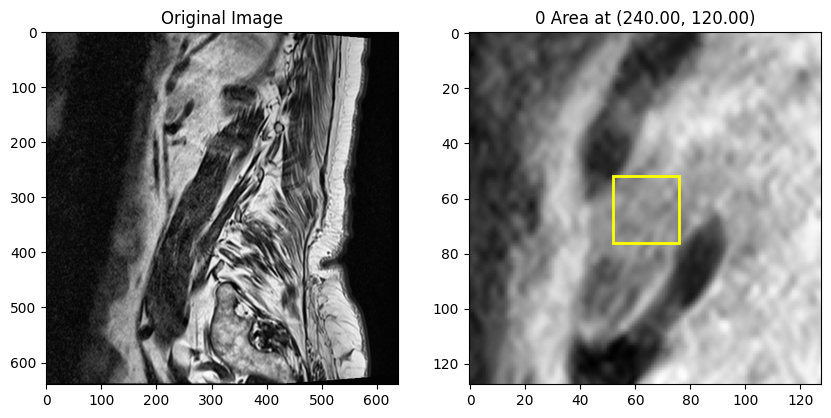

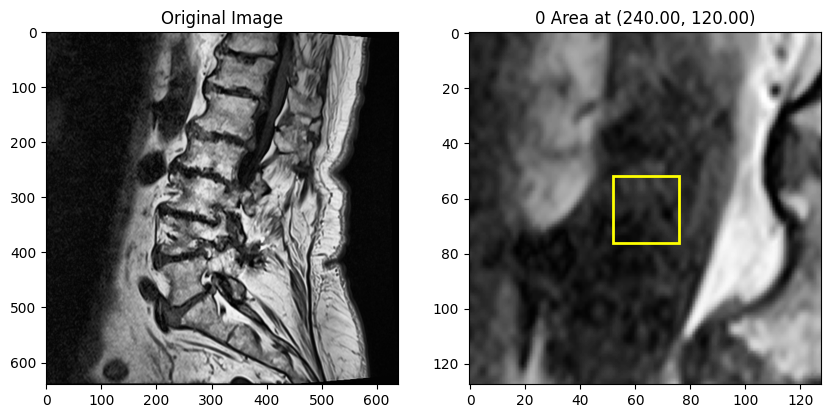

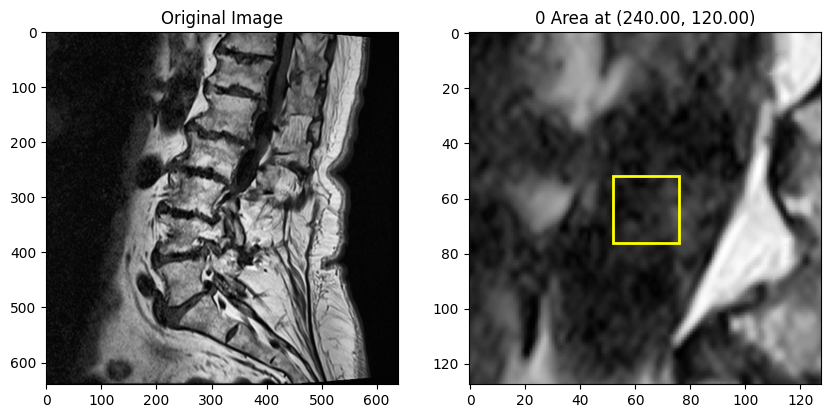

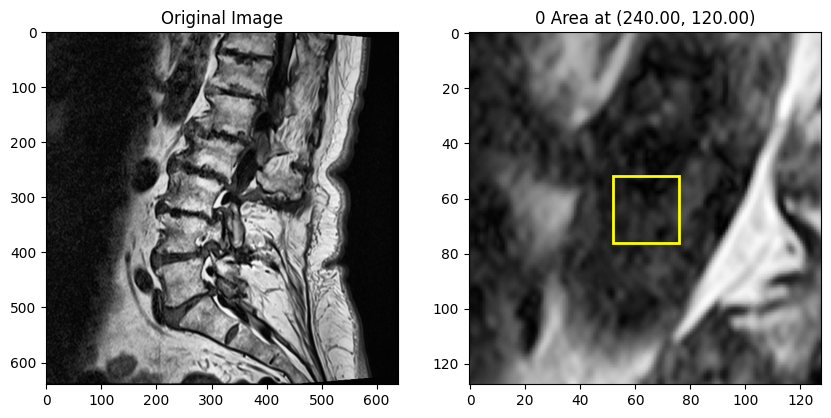

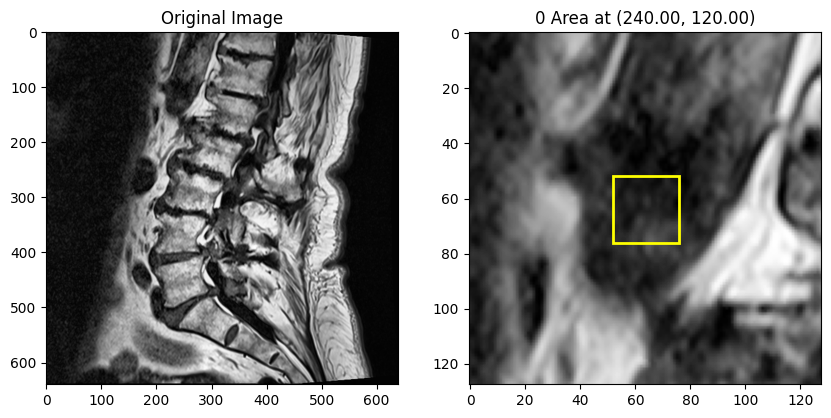

...

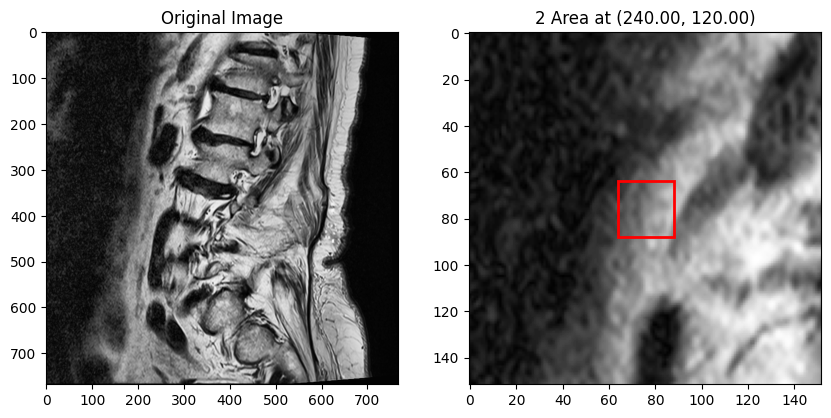

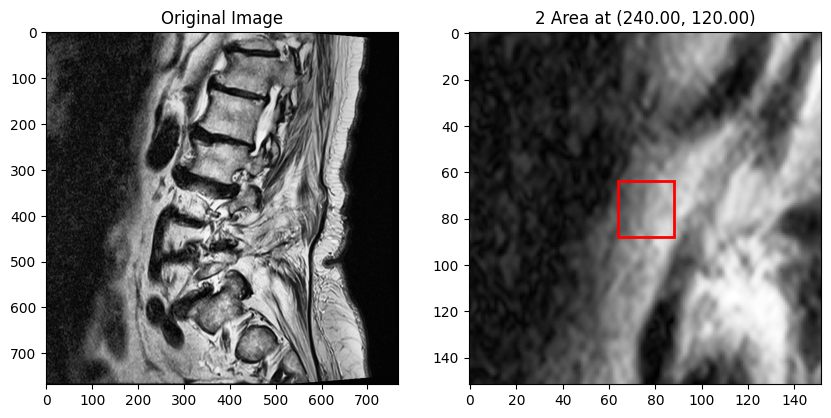

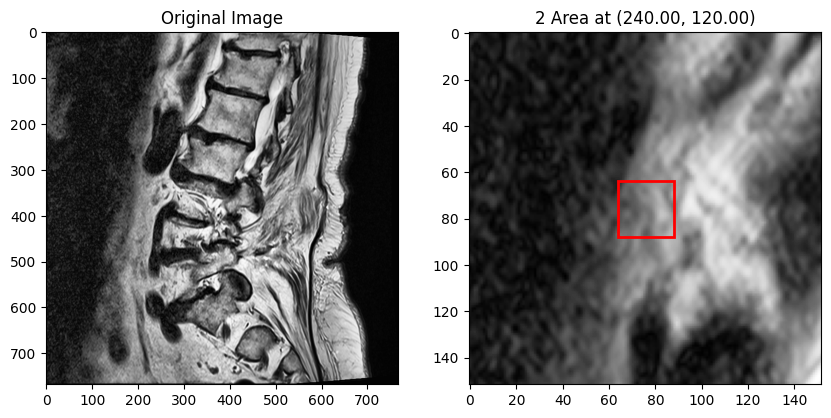

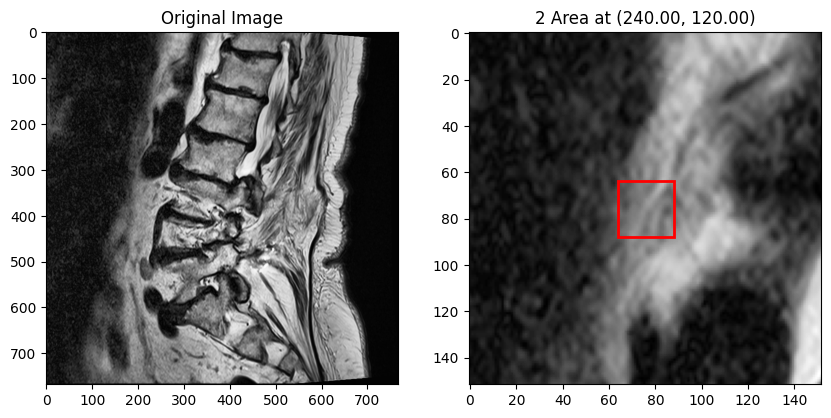

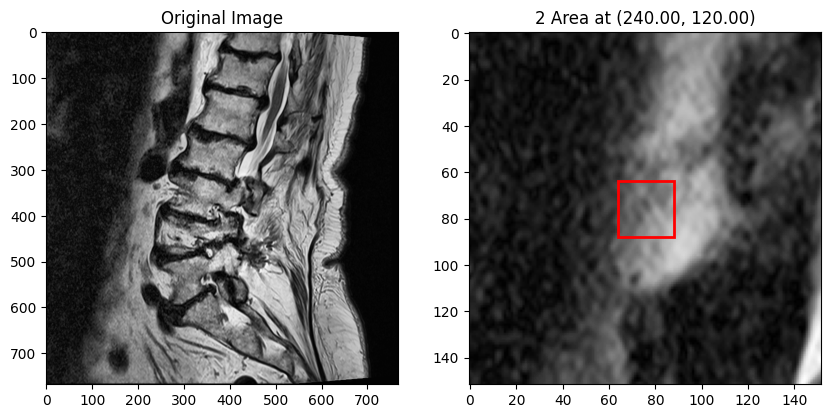

X_test_images shape: (97, 128, 128)
X_test_conditions shape: (97,)
X_test_levels shape: (97,)
X_test_images shape after resizing: (97, 64, 64, 1)
X_test_conditions shape after encoding: (97, 3)
X_test_levels shape after encoding: (97, 3)


In [54]:
df_test = df_test_sd.merge(df_train_lc[['study_id', 'series_id', 'x', 'y', 'condition', 'level', 'target']], on=['study_id', 'series_id'], how='left')


df_test = df_test.dropna(subset=['x', 'y', 'condition', 'level', 'target'])


if df_test.empty:
  df_test = pd.DataFrame({
      'study_id': [44036939, 44036939, 44036939],
      'series_id': [2828203845, 3481971518, 3844393089],
      'x': [240, 240, 240],
      'y': [120, 120, 120],
      'condition': [0, 1, 2],
      'level': [0, 1, 2],
      'target': [0, 1, 2]
  })

X_test_images, X_test_conditions, X_test_levels, _ = load_images_from_study(df_test, 'kaggle/input/rsna-2024-lumbar-spine-degenerative-classification/test_images')


if X_test_images.size == 0 or X_test_conditions.size == 0 or X_test_levels.size == 0:
  raise ValueError("Error")

min_samples = min(X_test_images.shape[0], X_test_conditions.shape[0], X_test_levels.shape[0])

X_test_images = X_test_images[:min_samples]
X_test_conditions = X_test_conditions[:min_samples]
X_test_levels = X_test_levels[:min_samples]

print(f"X_test_images shape: {X_test_images.shape}")
print(f"X_test_conditions shape: {X_test_conditions.shape}")
print(f"X_test_levels shape: {X_test_levels.shape}")

X_test_images_resized = np.array([cv2.resize(image, (64, 64)) for image in X_test_images])
X_test_images_resized = X_test_images_resized.reshape(-1, 64, 64, 1)

X_test_conditions_encoded = to_categorical(X_test_conditions)
X_test_levels_encoded = to_categorical(X_test_levels)

print(f"X_test_images shape after resizing: {X_test_images_resized.shape}")
print(f"X_test_conditions shape after encoding: {X_test_conditions_encoded.shape}")
print(f"X_test_levels shape after encoding: {X_test_levels_encoded.shape}")